In [81]:
import rasterio as rio
import os
import json
import pandas as pd
from PIL import ImageColor
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
import numpy as np
import matplotlib.pyplot as plt
import keras
from skimage.exposure import rescale_intensity
from keras.layers import Conv2D, Conv2DTranspose, Dropout, MaxPooling2D, Input, concatenate
from keras.models import Model
from keras.utils import to_categorical
from keras.callbacks import EarlyStopping
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

In [2]:
# Location of data
lc_dir = 'data/lc.json'
lc_image_dir = 'https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/LC_Image_v1.tif'
palsar_dir = "https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/Palsar_Kerinci_2023_v1.tif"
landsat_dir = "https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/Landsat_Kerinci_2023_v1.tif"

In [71]:
# Load Land Cover Parameter
lc = json.load(open(lc_dir))
lc_df = pd.DataFrame(lc)
lc_df["values_normalize"] = lc_df.index + 1
lc_df["palette"] = "#" + lc_df["palette"]

# Mapping from old to new values
values = lc_df["values"].to_list()
values_norm = lc_df["values_normalize"].to_list()
palette = lc_df["palette"].to_list()
labels = lc_df["label"].to_list()
dict_values = {}
dict_label = {}
dict_palette = {}
dict_palette_hex = {}
for x in range(0, len(values)):
    dict_values[values[x]] = values_norm[x]
    dict_label[values_norm[x]] = labels[x]
    dict_palette[values_norm[x]] = ImageColor.getrgb(palette[x])
    dict_palette_hex[values_norm[x]] = palette[x]

# Create colormap from values and palette
cmap = ListedColormap(palette)

# Patches legend
patches = [
    mpatches.Patch(color=palette[i], label=labels[i]) for i in range(len(values))
]
legend = {
    "handles": patches,
    "bbox_to_anchor": (1.05, 1),
    "loc": 2,
    "borderaxespad": 0.0,
}

lc_df

,palette,values,label,values_normalize
0,#006400,2001,Primary dryland forest,1
1,#228B22,2002,Secondary dryland forest,2
2,#4B0082,2004,Primary mangrove forest,3
3,#808000,2005,Primary swamp forest,4
4,#32CD32,2006,Plantation forest,5
5,#90EE90,2007,Dry shrub,6
6,#FF4500,2010,Estate crop,7
7,#F08080,2012,Settlement,8
8,#D2B48C,2014,Bare ground,9
9,#ADFF2F,3000,Savanna and grasses,10


In [4]:
# load image sample
lc_values = os.listdir('data/images')
lc_values = list(map(lambda x: int(x.split('_')[0]), lc_values))
lc_values = np.unique(lc_values)
lc_values.sort()
lc_values

array([ 1,  2,  5,  6,  7,  8,  9, 11, 14, 15, 16, 17, 20, 22])

In [5]:
# Function to augment and add more sample
def augment(array, list):
	flip = np.flip(array, 1)
	for arr in [array, flip]:
		for rot in [1, 2, 3]:
			list.append(np.rot90(arr, rot))

c:\Users\ramiq\Scripts\deep-learning-lc\.venv\lib\site-packages\rasterio\__init__.py:367: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


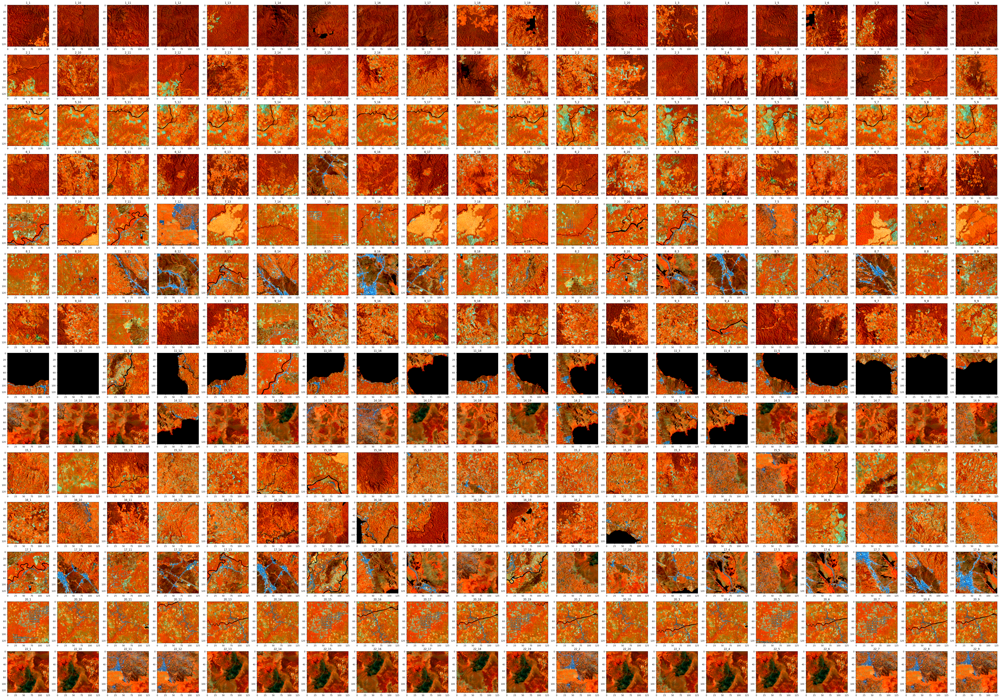

In [6]:
# Define image per land cover
image_per_lc = 20
index_train = int(8 / 10 * image_per_lc)

plt.figure(figsize=(4 * image_per_lc, 4 * len(lc_values)))

# List of images
images_train = []
images_test = []

# Load image first
for x in range(0, len(lc_values)):
	lc = lc_values[x]
	images_list = os.listdir('data/images')
	images_list = list(filter(lambda x: int(x.split('_')[0]) == lc, images_list))

	for y in range(0, len(images_list)):
		dir = images_list[y]
		name = dir.split('.')[0]
		image_dir = f'data/images/{dir}'
		source = rio.open(image_dir)

		# Make it into a image shape to plot
		image = np.transpose(source.read(), (1, 2, 0))

		# Augment then add to the list
		augment(image, images_train if (y < index_train) else images_test)

		# Plot the image
		plt.subplot(len(lc_values), image_per_lc, x * image_per_lc + y + 1)
		plt.imshow(image)
		plt.title(f'{name}')

		source.close()

# Turn in into numpy array stacks
images_train = np.stack(images_train)
images_test = np.stack(images_test)

c:\Users\ramiq\Scripts\deep-learning-lc\.venv\lib\site-packages\rasterio\__init__.py:367: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


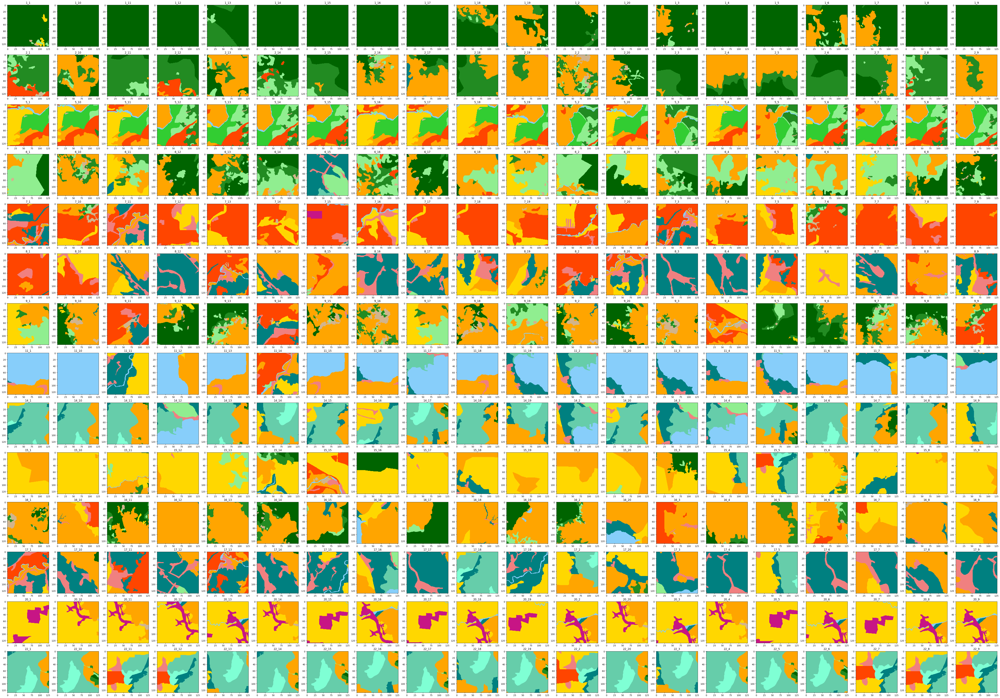

In [73]:
# Load lc first
plt.figure(figsize=(4 * image_per_lc, 4 * len(lc_values)))

lcs_train = []
lcs_test = []

for x in range(0, len(lc_values)):
	lc = lc_values[x]
	images_list = os.listdir('data/lcs')
	images_list = list(filter(lambda x: int(x.split('_')[0]) == lc, images_list))

	for y in range(0, len(images_list)):
		dir = images_list[y]
		name = dir.split('.')[0]
		image_dir = f'data/lcs/{dir}'
		source = rio.open(image_dir)
		image = source.read()

		# Transposed the image into an image object
		transposed = np.transpose(image, (1, 2, 0))

		# Augment then add to the list
		augment(transposed, lcs_train if (y < index_train) else lcs_test)

		# Plot the land cover
		plt.subplot(len(lc_values), image_per_lc, x * image_per_lc + y + 1)
		plt.imshow(image[0], cmap=cmap, interpolation='nearest', vmin=1, vmax=22)
		plt.title(f'{name}')

		source.close()

lcs_train = np.stack(lcs_train)
lcs_test = np.stack(lcs_test)

In [8]:
print(f'Train_predictors_shape: {images_train.shape}\nTrain_label_shape: {lcs_train.shape}\nTest_predictors_shape: {images_test.shape}\nTest_label_shape: {lcs_test.shape}')

Train_predictors_shape: (1344, 128, 128, 3)
Train_label_shape: (1344, 128, 128, 1)
Test_predictors_shape: (336, 128, 128, 3)
Test_label_shape: (336, 128, 128, 1)


In [9]:
# Make lcs data into categorical
lcs_train_category = to_categorical(lcs_train)
lcs_test_category = to_categorical(lcs_test)

In [ ]:
# Make keras model
input_shape = images_train.shape
input_shape = (input_shape[1], input_shape[2], input_shape[3])

neuron = 64
kernel = 3
kernel_t = 2
dropout = 0.1
strides = 2
pool = 2
padding = 'same'

input_layer = Input(input_shape)

def conv2_block(input, neuron, last=False):
	conv1 = Conv2D(neuron, kernel, activation='relu', padding=padding)(input)
	conv2 = Conv2D(neuron, kernel, activation='relu', padding=padding)(conv1)
	return conv2

def encode(input, neuron):
	conv1 = conv2_block(input, neuron)
	mp = MaxPooling2D(2)(conv1)
	dp = Dropout(dropout)(mp)
	return conv1, dp

def decode(input, conv, neuron):
	conv_t = Conv2DTranspose(neuron, kernel_t, strides, activation='relu', padding=padding)(input)
	concat = concatenate([conv_t, conv])
	conv2 = conv2_block(concat, neuron)
	dp = Dropout(dropout)(conv2)
	return dp

conv1, mp1 = encode(input_layer, neuron * 1)
conv2, mp2 = encode(mp1, neuron * 2)
conv3, mp3 = encode(mp2, neuron * 4)
conv4, mp4 = encode(mp3, neuron * 8)

transition = conv2_block(mp4, neuron * 16)

uncov1 = decode(transition, conv4, neuron * 8)
uncov2 = decode(uncov1, conv3, neuron * 4)
uncov3 = decode(uncov2, conv2, neuron * 2)
uncov4 = decode(uncov3, conv1, neuron * 1)

output = Conv2D(lcs_train_category.shape[3], 1, padding=padding, activation='softmax')(uncov4)

model = Model(input_layer, output)
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 128, 128,  │      1,792 │ input_layer_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 128, 128,  │     36,928 │ conv2d_8[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 64, 64,    │          0 │ conv2d_9[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_4 (Dropout) │ (None, 64, 64,    │          0 │ max_pooling2d_4[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_10 (Conv2D)  │ (None, 64, 64,    │     73,856 │ dropout_4[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_11 (Conv2D)  │ (None, 64, 64,    │    147,584 │ conv2d_10[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_5     │ (None, 32, 32,    │          0 │ conv2d_11[0][0]   │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_5 (Dropout) │ (None, 32, 32,    │          0 │ max_pooling2d_5[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_12 (Conv2D)  │ (None, 32, 32,    │    295,168 │ dropout_5[0][0]   │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_13 (Conv2D)  │ (None, 32, 32,    │    590,080 │ conv2d_12[0][0]   │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 16, 16,    │          0 │ conv2d_13[0][0]   │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_6 (Dropout) │ (None, 16, 16,    │          0 │ max_pooling2d_6[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_14 (Conv2D)  │ (None, 16, 16,    │  1,180,160 │ dropout_6[0][0]   │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_15 (Conv2D)  │ (None, 16, 16,    │  2,359,808 │ conv2d_14[0][0]   │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_7     │ (None, 8, 8, 512) │          0 │ conv2d_15[0][0]   │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_7 (Dropout) │ (None, 8, 8, 512) │          0 │ max_pooling2d_7[

 Total params: 31,033,175 (118.38 MB)

 Trainable params: 31,033,175 (118.38 MB)

 Non-trainable params: 0 (0.00 B)

In [12]:
# Compile and build the model
model.compile(
	optimizer=keras.optimizers.Adam(0.001),
	loss=keras.losses.CategoricalCrossentropy(),
	metrics=[keras.metrics.CategoricalAccuracy()
])

callbacks = [
	EarlyStopping(patience=3, monitor='val_loss')
]

result = model.fit(
	x=images_train,
	y=lcs_train_category,
	epochs=50,
	batch_size=16,
	shuffle=True,
	validation_split=0.1,
	callbacks=callbacks
)

Epoch 1/100
152/152 ━━━━━━━━━━━━━━━━━━━━ 100s 639ms/step - categorical_accuracy: 0.2132 - loss: 2.7723 - val_categorical_accuracy: 0.1201 - val_loss: 2.4707
Epoch 2/100
152/152 ━━━━━━━━━━━━━━━━━━━━ 95s 627ms/step - categorical_accuracy: 0.3000 - loss: 2.1585 - val_categorical_accuracy: 0.1114 - val_loss: 2.5011
Epoch 3/100
152/152 ━━━━━━━━━━━━━━━━━━━━ 95s 627ms/step - categorical_accuracy: 0.3882 - loss: 1.8257 - val_categorical_accuracy: 0.1118 - val_loss: 2.5002
Epoch 4/100
152/152 ━━━━━━━━━━━━━━━━━━━━ 95s 623ms/step - categorical_accuracy: 0.4202 - loss: 1.7145 - val_categorical_accuracy: 0.0449 - val_loss: 2.8657
Epoch 5/100
152/152 ━━━━━━━━━━━━━━━━━━━━ 95s 624ms/step - categorical_accuracy: 0.4349 - loss: 1.6741 - val_categorical_accuracy: 0.2435 - val_loss: 2.0943
Epoch 6/100
152/152 ━━━━━━━━━━━━━━━━━━━━ 95s 624ms/step - categorical_accuracy: 0.4411 - loss: 1.6004 - val_categorical_accuracy: 0.1431 - val_loss: 2.1114
Epoch 7/100
152/152 ━━━━━━━━━━━━━━━━━━━━ 94s 621ms/step - categ

    categorical_accuracy      loss  val_categorical_accuracy  val_loss
0               0.236824  2.536292                  0.120096  2.470690
1               0.331884  2.033819                  0.111394  2.501068
2               0.402528  1.777206                  0.111783  2.500178
3               0.426644  1.692948                  0.044893  2.865709
4               0.438502  1.638903                  0.243518  2.094309
..                   ...       ...                       ...       ...
87              0.958582  0.102185                  0.885638  0.551841
88              0.957116  0.106276                  0.891570  0.521692
89              0.958712  0.101686                  0.889594  0.534051
90              0.958726  0.101769                  0.889219  0.530457
91              0.953085  0.118271                  0.885604  0.563129

[92 rows x 4 columns]


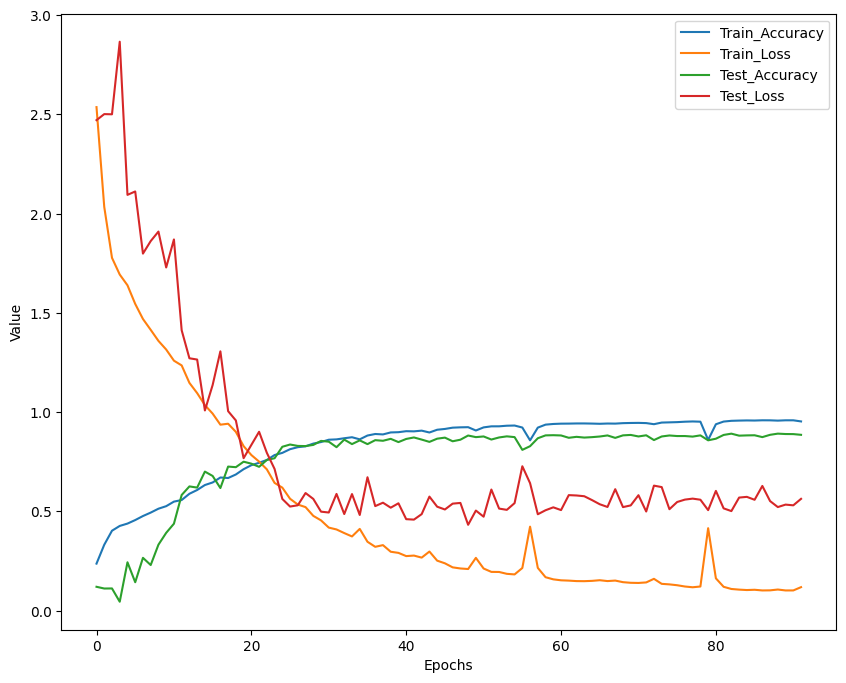

In [13]:
# Show history
history = pd.DataFrame(result.history)
print(history)

plt.figure(figsize = (10, 8))
plt.plot(range(len(history['categorical_accuracy'].values.tolist())), history['categorical_accuracy'].values.tolist(), label = 'Train_Accuracy')
plt.plot(range(len(history['loss'].values.tolist())), history['loss'].values.tolist(), label = 'Train_Loss')
plt.plot(range(len(history['val_categorical_accuracy'].values.tolist())), history['val_categorical_accuracy'].values.tolist(), label = 'Test_Accuracy')
plt.plot(range(len(history['val_loss'].values.tolist())), history['val_loss'].values.tolist(), label = 'Test_Loss')
plt.xlabel('Epochs')
plt.ylabel('Value')
plt.legend()
plt.show()

In [21]:
# Predict test data
prediction = np.argmax(model.predict(images_test), 3).flatten()
label = lcs_test.flatten()

11/11 ━━━━━━━━━━━━━━━━━━━━ 8s 689ms/step


              precision    recall  f1-score   support

           1       0.83      0.88      0.86    605868
           2       0.57      0.64      0.60    348864
           5       0.95      0.97      0.96    113130
           6       0.64      0.54      0.58    280854
           7       0.80      0.79      0.79    521778
           8       0.75      0.84      0.79    157776
           9       0.26      0.17      0.21     24348
          11       0.97      0.98      0.97    310884
          14       0.94      0.84      0.89    382506
          15       0.81      0.68      0.74   1058826
          16       0.68      0.79      0.73   1082856
          17       0.88      0.88      0.88    503682
          20       0.84      0.94      0.89     53670
          22       0.91      0.85      0.88     59982

    accuracy                           0.78   5505024
   macro avg       0.77      0.77      0.77   5505024
weighted avg       0.79      0.78      0.78   5505024



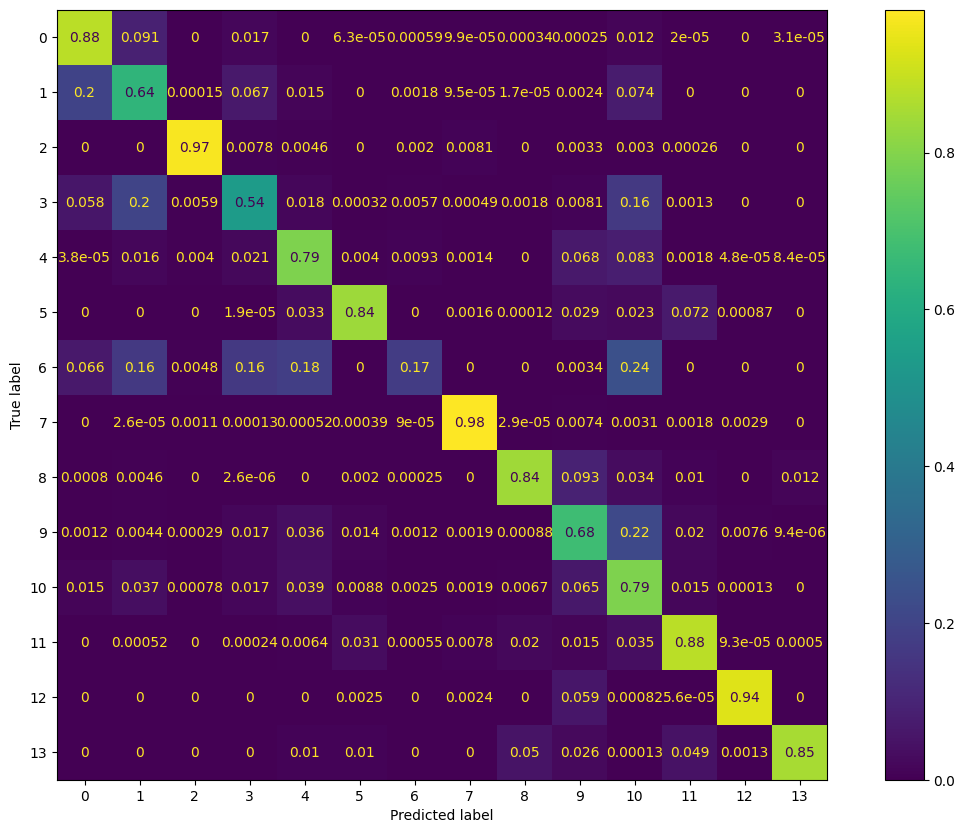

In [24]:
# Confusion matrix
cm = confusion_matrix(label, prediction, normalize='true')
fig, ax = plt.subplots(figsize=(15, 10))
cm = ConfusionMatrixDisplay(cm)
cm.plot(ax = ax)

# Classification report
print(classification_report(label, prediction))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━

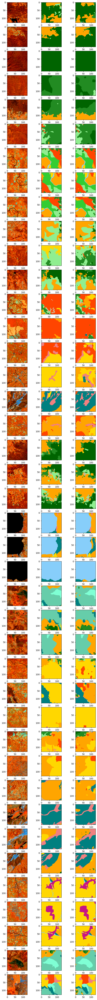

In [80]:
image_non_augment_size = int(len(images_test) / 8)

plt.figure(figsize=(8, image_non_augment_size * 2))

# Apply to classified image of the image
for x in range(0, image_non_augment_size - 1):
	index = x * 8

	image = images_test[index:(index + 1)]
	pred = model.predict(image)
	pred = np.argmax(pred, 3)[0]

	plt.subplot(image_non_augment_size, 3, x * 3 + 1)
	plt.imshow(image[0])

	plt.subplot(image_non_augment_size, 3, x * 3 + 2)
	plt.imshow(lcs_test[index], cmap=cmap, interpolation='nearest', vmin=1, vmax=22)

	plt.subplot(image_non_augment_size, 3, x * 3 + 3)
	plt.imshow(pred, cmap=cmap, interpolation='nearest', vmin=1, vmax=22)

In [16]:
# Save model
model.save('data/dl_unet_landcover_model_v1.keras')